In [23]:
#!pip install regex
import re
#!pip install scipy
from scipy.spatial import distance
#!pip install numpy
import numpy as np
#!pip install pandas
import pandas as pd

In [32]:
patternATOM = re.compile("ATOM.*CA +([A-Z]{3}) +[A]{1}")
patternCOOR_CA = re.compile("^ATOM.*CA +([A-Z]{3}) +[A]{1} *([0-9]+) +(\-?[0-9\.]+)+ +(\-?[0-9\.]+) +(\-?[0-9\.]+) +(\-?[0-9\.]+)")

coor = []

for i, line in enumerate(open('example_file.pdb')):
    #print(line)
    for match in re.finditer(patternATOM, line):
        #print(line)
        coordinateSearch = re.search(patternCOOR_CA,line)
        if coordinateSearch:
            aa= coordinateSearch.group(1)
            n = coordinateSearch.group(2)
            x = float(coordinateSearch.group(3))
            y = float(coordinateSearch.group(4))
            z = float(coordinateSearch.group(5))
            
            coor.append([aa+' '+n , x , y , z])
            

pdbCoor = pd.DataFrame( coor , columns = ['AA', 'x', 'y', 'z' ] )
print( pdbCoor )

          AA       x       y       z
0      PRO 4  60.307  -7.450  17.179
1      LEU 5  59.549  -6.737  20.825
2      ASP 6  56.247  -5.487  22.184
3      PHE 7  56.107  -2.164  24.012
4      GLN 8  55.933  -3.978  27.346
..       ...     ...     ...     ...
973  LEU 995  89.733  65.258   8.205
974  GLU 996  93.393  64.488   8.866
975  GLY 997  94.783  67.114   6.485
976  PHE 998  92.647  69.903   7.947
977  GLY 999  95.340  71.005  10.408

[978 rows x 4 columns]


In [110]:
xyz= pdbCoor[['x','y','z']]
xyz.iloc[0].values
dist = distance.pdist([xyz.iloc[0].values, xyz.iloc[0].values])
#distance.pdist(pdbCoor)
print(dist[0])

0.0


In [164]:
# Calculate distances
distances = []
for i in range(len(pdbCoor)):
    distances.append([])
    for j in range(i, len(pdbCoor)):
        dist = distance.pdist([xyz.iloc[i].values, xyz.iloc[j].values])
        #print('({}, {}): {:.5f}'.format(xyz.iloc[i].values , xyz.iloc[j].values , dist))
        distances[i].append(dist[0])
        #print(dist)
        
distances

[[0.0,
  3.791602431690328,
  6.73698701201064,
  9.605815165825337,
  11.599765040723888,
  9.292694173381584,
  9.270310782276937,
  12.988986142112866,
  13.576360447483708,
  12.093123583260033,
  14.32676798862884,
  17.158965324284562,
  16.97308292562079,
  16.937323932664214,
  19.78924503360348,
  21.667612720371384,
  21.659368458013727,
  23.307254171180265,
  25.999580881237303,
  25.280195984208667,
  26.358053209598012,
  23.790712095269445,
  25.34386509591621,
  24.852175558691037,
  25.020644156376154,
  28.683067444051378,
  30.77498173841863,
  31.9229843842959,
  30.538849618150323,
  29.713907282617683,
  28.78129505425355,
  26.564836099626138,
  25.55400665257799,
  28.57664476456255,
  30.940261214152667,
  29.853829921804007,
  32.7094055739324,
  30.285380103277554,
  30.25915697768198,
  33.38533788955864,
  35.80978673491368,
  34.2995715862458,
  34.34308637848381,
  38.087729927103815,
  40.51520935401914,
  40.342735851699494,
  38.36418389592042,
  35.04

In [168]:
# Calculate distances
#distances = []
for i in reversed(range(len(pdbCoor))):
    for j in reversed(range(0, len(pdbCoor))):
        if len(distances[i])< len(pdbCoor):
            distances[len(pdbCoor)-i][len(pdbCoor)-j]= distances[i][j]
        #distances[4-i].append(2)
        #print(dist)
        
distances

[[0.0,
  3.791602431690328,
  6.73698701201064,
  9.605815165825337,
  11.599765040723888,
  9.292694173381584,
  9.270310782276937,
  12.988986142112866,
  13.576360447483708,
  12.093123583260033,
  14.32676798862884,
  17.158965324284562,
  16.97308292562079,
  16.937323932664214,
  19.78924503360348,
  21.667612720371384,
  21.659368458013727,
  23.307254171180265,
  25.999580881237303,
  25.280195984208667,
  26.358053209598012,
  23.790712095269445,
  25.34386509591621,
  24.852175558691037,
  25.020644156376154,
  28.683067444051378,
  30.77498173841863,
  31.9229843842959,
  30.538849618150323,
  29.713907282617683,
  28.78129505425355,
  26.564836099626138,
  25.55400665257799,
  28.57664476456255,
  30.940261214152667,
  29.853829921804007,
  32.7094055739324,
  30.285380103277554,
  30.25915697768198,
  33.38533788955864,
  35.80978673491368,
  34.2995715862458,
  34.34308637848381,
  38.087729927103815,
  40.51520935401914,
  40.342735851699494,
  38.36418389592042,
  35.04

In [162]:
# Calculate distances
distances = []
for i in range(7):
    distances.append([])
    for j in range(i, 7):
        #dist = distance.pdist([xyz.iloc[i].values, xyz.iloc[j].values])
        #print('({}, {}): {:.5f}'.format(xyz.iloc[i].values , xyz.iloc[j].values , dist))
        distances[i].append(j)
        #distances[4-i].append(2)
        #print(dist)
        
distances

[[0, 1, 2, 3, 4, 5, 6],
 [1, 2, 3, 4, 5, 6],
 [2, 3, 4, 5, 6],
 [3, 4, 5, 6],
 [4, 5, 6],
 [5, 6],
 [6]]

In [163]:
# Calculate distances
#distances = []
for i in reversed(range(7)):
    #distances.append([])
    for j in reversed(range(0, 6)):
        #dist = distance.pdist([xyz.iloc[i].values, xyz.iloc[j].values])
        #print('({}, {}): {:.5f}'.format(xyz.iloc[i].values , xyz.iloc[j].values , dist))
        if len(distances[i])<7:
            distances[i].append(j)
        #distances[4-i].append(2)
        #print(dist)
        
distances

[[0, 1, 2, 3, 4, 5, 6],
 [1, 2, 3, 4, 5, 6, 5],
 [2, 3, 4, 5, 6, 5, 4],
 [3, 4, 5, 6, 5, 4, 3],
 [4, 5, 6, 5, 4, 3, 2],
 [5, 6, 5, 4, 3, 2, 1],
 [6, 5, 4, 3, 2, 1, 0]]

TypeError: Image data of dtype object cannot be converted to float

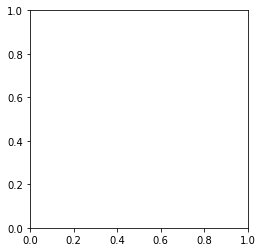

In [119]:
#!pip install matplotlib
import matplotlib.pyplot as plt

plt.imshow(distances)


In [ ]:
#scipy.spatial.distance.pdist
#matplotlib.pyplot.imshow